In [1]:
import besseTBC
import numpy as np
import matplotlib.pyplot as plt
import kdv
import generalFunctions as gF

%matplotlib inline

# First test : $u_0(x) = e^{-x^2}$

In [7]:
L = 6.
xmin = -L
xmax = L
N = 500.
U2 = 1.
t0 = 0.
tmax = 4.
dt = 5*4/2560.

dx = (xmax-xmin)/N
x = kdv.discretizeSpace(xmin,xmax,dx)
x = np.linspace(xmin,xmax,N)
cLs = np.arange(0.9, 1.1, 0.1)
cRs = np.array([2.])

u = besseTBC.initGauss(x)

tallaux = np.arange(t0,tmax+dt,dt)

uallexact = np.zeros((u.size,tallaux.size))
uallexact[:,0] = np.copy(u)
for i in range(1,tallaux.size) :
    uallexact[:,i] = besseTBC.exactSolution(x,tallaux[i],besseTBC.initGauss)

filename = 'optimO0.json'
testsLight = besseTBC.loadTests(filename)

uall,uallexact,tall,tests,testsLight,errors,testTmmax,testTmmin,testL2max,testL2min = besseTBC.optimizeParamO0(x,u,uallexact,t0,tmax,
                                                    U2,cLs,cRs, N, dt, testsLight, verbose = True,LeD = False)

besseTBC.saveTests(testsLight,filename)

(array([ 0.9,  1. ,  1.1]), array([ 2.]))

*** Computing solution ...
*** End of computation ***
(0.90000000000000002, 2.0)

*** Computing solution ...
*** End of computation ***
(1.0, 2.0)

*** Computing solution ...
*** End of computation ***
(1.1000000000000001, 2.0)
(79, 3)
('ErrTm Max = ', 0.2674900835313811, '(cL,cR) = ', '(0.0, 1.0)')
('ErrTm Min = ', 0.077406207841361707, '(cL,cR) = ', '(1.1000000000000001, 2.0)')
('ErrL2 Max = ', 0.3978117383955158, '(cL,cR) = ', '(0.0, 0.0)')
('ErrL2 Min = ', 0.09275040175021648, '(cL,cR) = ', '(1.1500000000000004, 1.0)')


In [8]:
besseTBC.showRanking(testsLight,10,"L2")

Best results
('(1.100,2.000)', '0.0774062078414', '0.092512924002')
('(1.100,1.000)', '0.0777895764071', '0.0926555342798')
('(1.150,1.000)', '0.0693369297946', '0.0927504017502')
('(1.100,10.000)', '0.0788673542392', '0.0937532147684')
('(1.100,0.200)', '0.0798921796311', '0.0938842605668')
('(1.150,10.000)', '0.0716568306085', '0.0939725861342')
('(1.150,0.100)', '0.0718406949909', '0.0940625082376')
('(1.100,0.100)', '0.0803170965928', '0.0941728017393')
('(1.050,1.000)', '0.0869988401434', '0.0943867007971')
('(1.200,1.000)', '0.0710815689916', '0.0944336079322')



*** Computing solution ...
*** End of computation ***


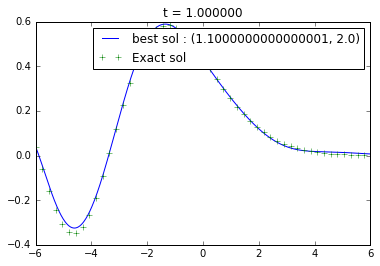

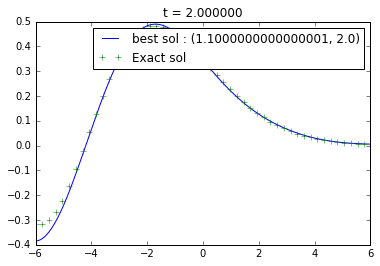

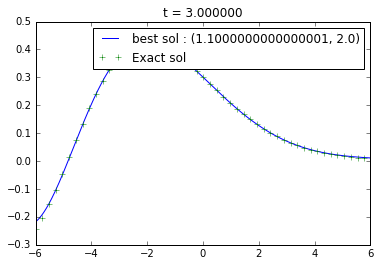

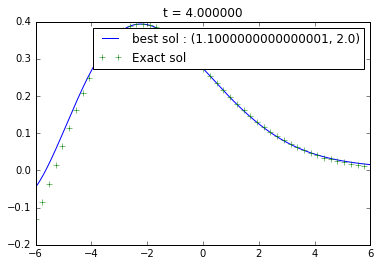

In [9]:
tsnaps = np.array([1.,2.,3.,4.])
besseTBC.plotBestSolution(x,u,uallexact,U2,t0,tmax,dt,tall,tsnaps,testsLight,criteria="L2")


*** Computing solution ...
*** End of computation ***
*** Plotting animation ...



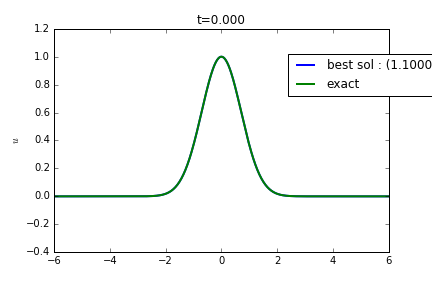
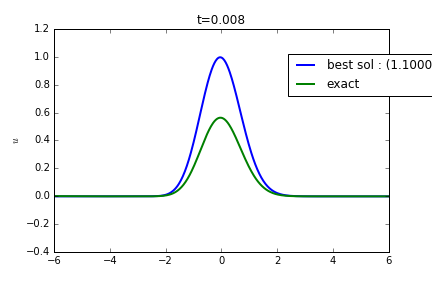
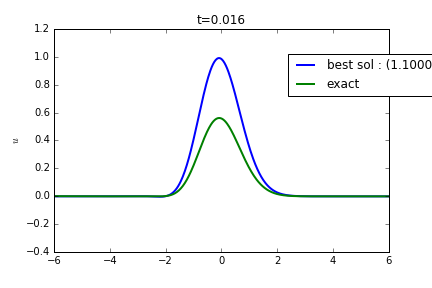
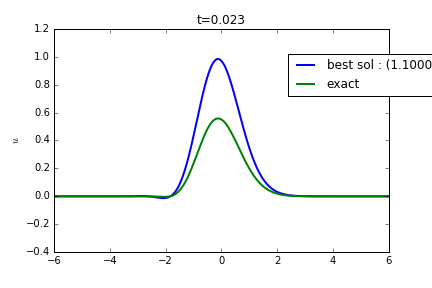
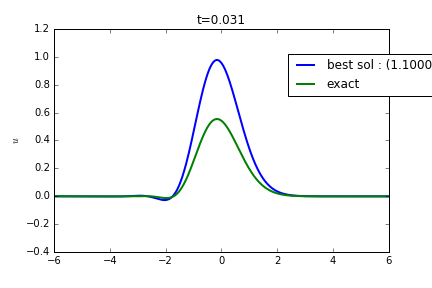
...
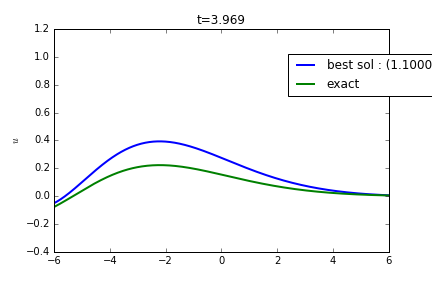
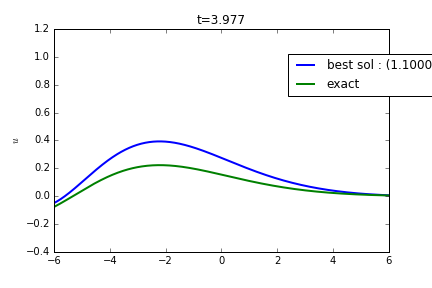
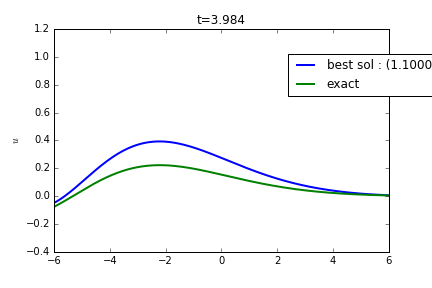
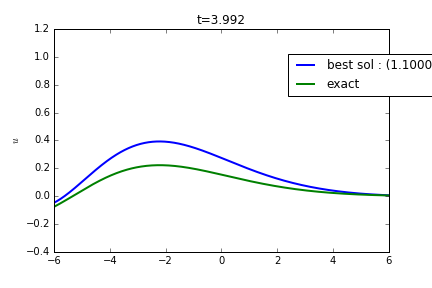
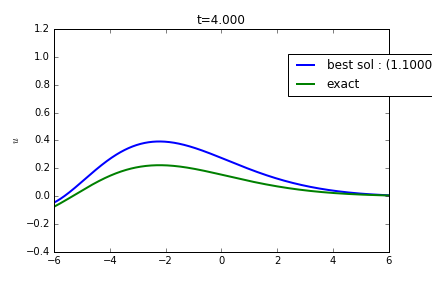

In [5]:
besseTBC.animateBestSolution(x,u,uallexact,U2,t0,tmax,dt,testsLight,criteria="L2")

# Second test : Square wave

In [ ]:
## L = 6.
xmin = -L
xmax = L
N = 500.
U2 = 1.
t0 = 0.
tmax = 4.
dt = 5*4/2560./2.

dx = (xmax-xmin)/N
x = kdv.discretizeSpace(xmin,xmax,dx)
x = np.linspace(xmin,xmax,N)
cLs = np.arange(0.8,1.25,.5)
cRs = np.array([0.])

u = f(x)

tallaux = np.arange(t0,tmax+dt,dt)

uallexact = np.zeros((u.size,tallaux.size))
uallexact[:,0] = np.copy(u)
for i in range(1,tallaux.size) :
    uallexact[:,i] = besseTBC.exactSolution(x,tallaux[i],f)

filename = 'optimO0square.json'
testsLight = besseTBC.loadTests(filename)

uall,uallexact,tall,tests,testsLight,errors,testTmmax,testTmmin,testL2max,testL2min = besseTBC.optimizeParamO0(x,u,uallexact,t0,tmax,
                                                    U2,cLs,cRs, N, dt, testsLight, verbose = True,LeD = False)

besseTBC.saveTests(testsLight,filename)

In [63]:
besseTBC.showRanking(testsLight,9,"L2")

Best results
('(1.000,0.000)', '0.216866610263', '0.292142151862')
('(1.000,1.000)', '0.218925233843', '0.292199979498')
('(1.000,10.000)', '0.218722869801', '0.292657095121')
('(10.000,0.000)', '0.329964502085', '0.48840483762')
('(10.000,1.000)', '0.330846341035', '0.490902265127')
('(10.000,10.000)', '0.335283184923', '0.492947470209')
('(0.000,0.000)', '0.336059633991', '0.522545765359')
('(0.000,10.000)', '0.327968861596', '0.523634216544')
('(0.000,1.000)', '0.3329606629', '0.524273065621')



*** Computing solution ...
*** End of computation ***


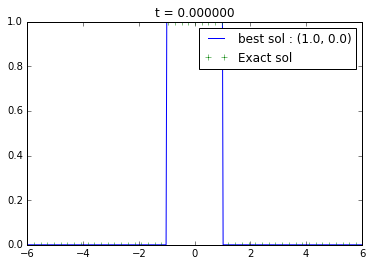

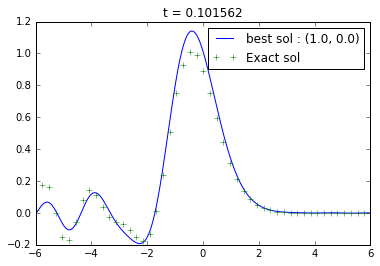

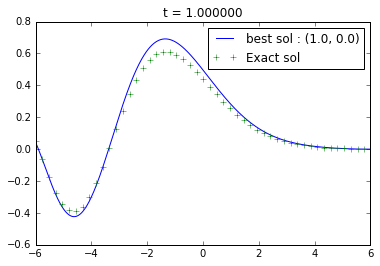

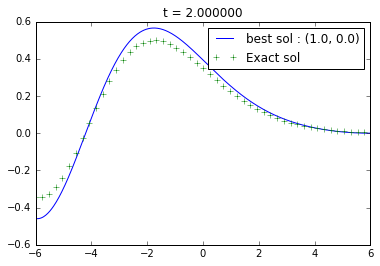

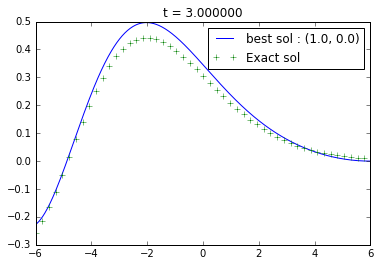

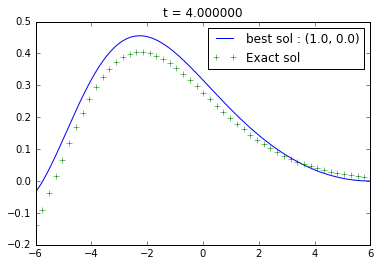

In [64]:
tsnaps = np.array([0.,0.1,1.,2.,3.,4.])
besseTBC.plotBestSolution(x,u,uallexact,U2,t0,tmax,dt,tall,tsnaps,testsLight,criteria="L2")


*** Computing solution ...
*** End of computation ***
*** Plotting animation ...



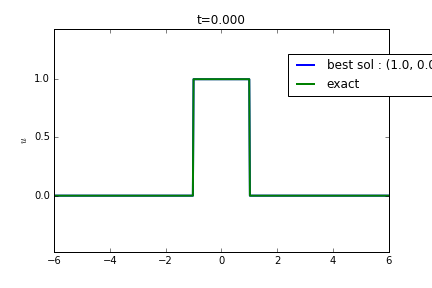
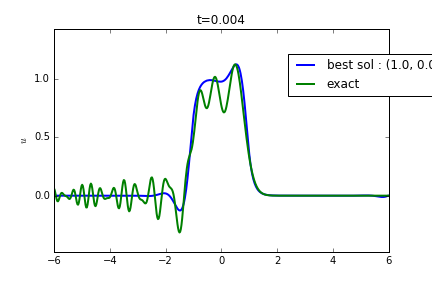
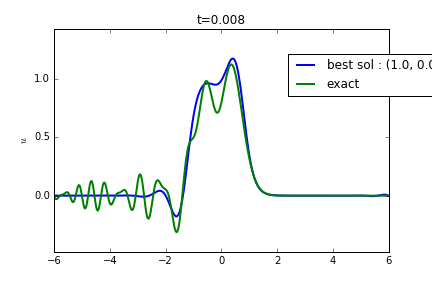
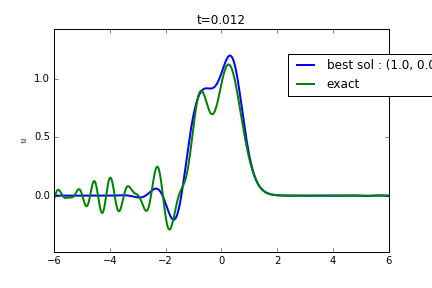
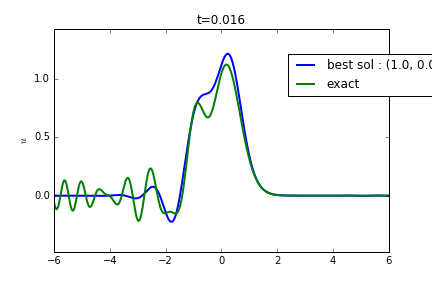
...
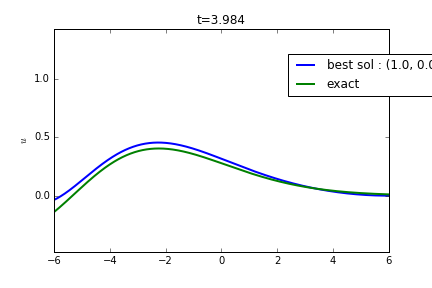
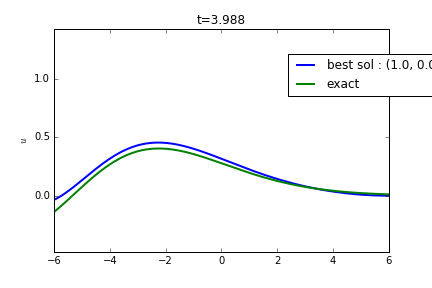
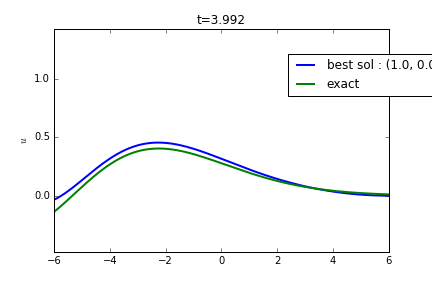
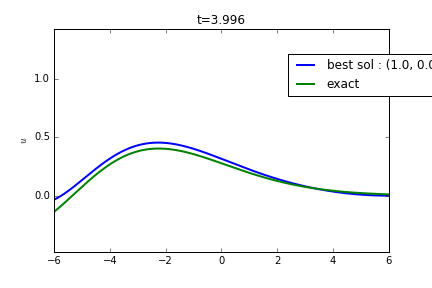
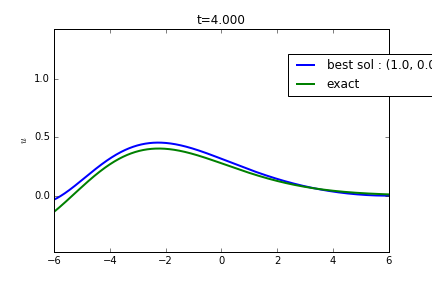

In [65]:
besseTBC.animateBestSolution(x,u,uallexact,U2,t0,tmax,dt,testsLight,criteria="L2")

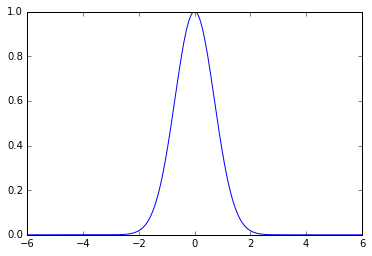

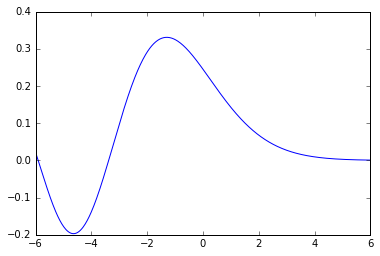

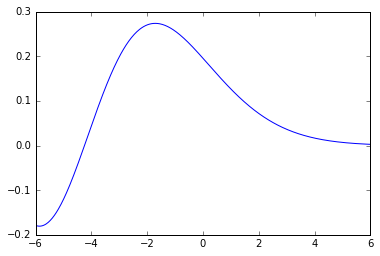

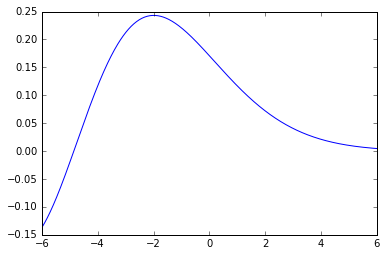

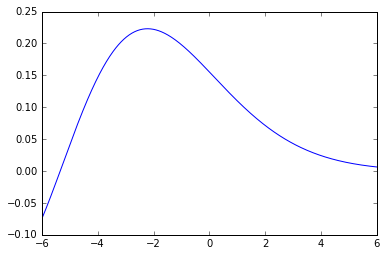

In [66]:
def f(x) :
    return np.where(x<-1,0.,np.where(x>1,0.,1.))

u = besseTBC.initGauss(x)
plt.plot(x,u)
for t in [1,2,3,4]:
    ue = besseTBC.exactSolution(x,t,besseTBC.initGauss)
    plt.figure()
    plt.plot(x,ue)